<h1><center>Generative Adversarial Networks</center></h1>

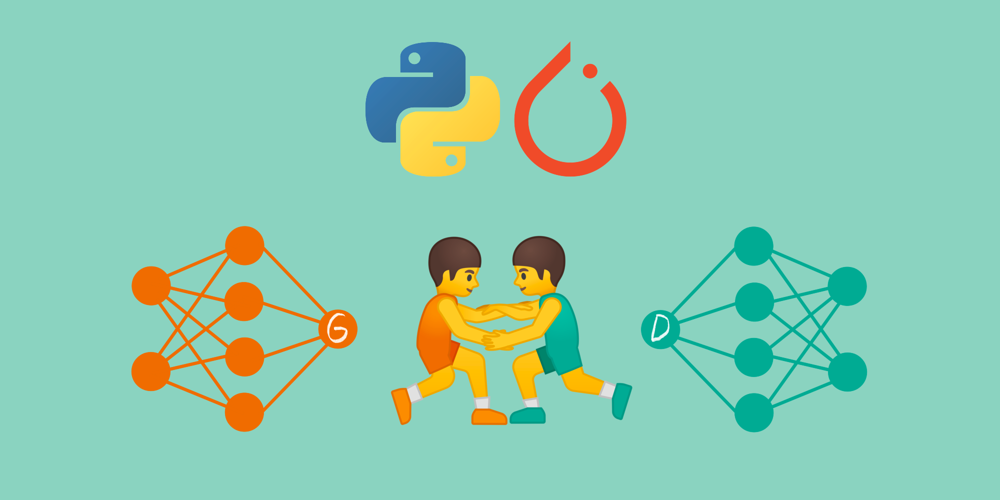

<h1><center>Часть 1. Теория</center></h1>

Начнем издалека...

## 1. Metric Learning 

Начнем объяснение с такой всем необходимой задачи, как распознавание лиц(Face recognition). Ниже представлен пример того как выглядит датасет для таких задач. Этот взят из [MegaFace](http://megaface.cs.washington.edu/) - один из самых больших датасетов по распознаванию лиц. Давайте посмотри что в этом датасете:

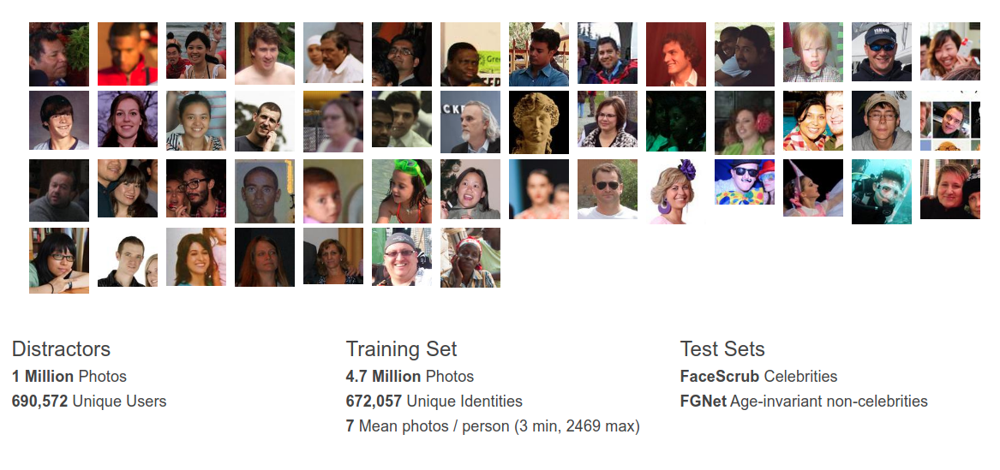

Собственно очень много изображений, очень много классов, при этом очень мало примеров изображений каждого класса. Давайте посмотрим какие задачи мы можем решать:

* Кто из людей в тренировочных данных изображен на новом фото? (теоритически можем решить теми методами которые мы знаем. Но с натяжкой..)
* На двух новых фото один и тот же человек или нет? (пока не понятно что делать)
* Даны 3 фото нового человека. Изображен ли он на еще одном фото? (задача поиска по фотографии)

Давайте посмотрим как можно к этим задачам подходить:

### 1.1 Embeddings. Признаки предпоследнего слоя

Рассмотрим обычную сверточную архитектуру классификации изображений(В данном случае [AlexNet](https://papers.nips.cc/paper/2012/file/c399862d3b9d6b76c8436e924a68c45b-Paper.pdf)):

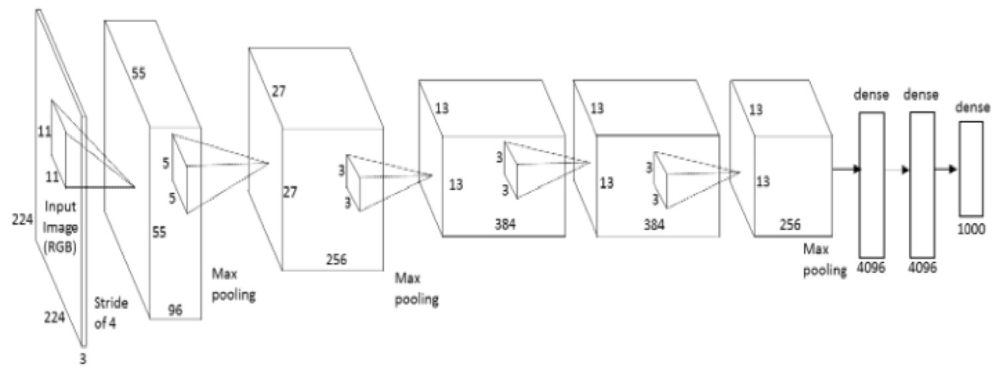

Обратим внимание на самый последний слой перед выходом. Этот слой - вектор из 4096 элементов, в котором суммиризируется вся информация про то, что наша сеть знает про входную картинку. 

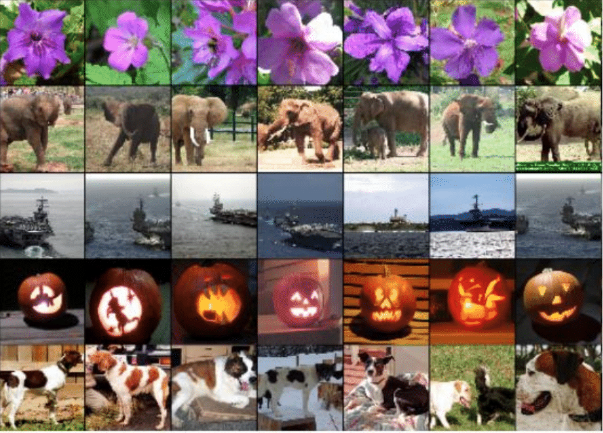

В данном случае, мы получем что картинки близки друг другу, если их вектора с нашего рассмотренного слоя близки друг другу векторном пространстве. Собственно, этот вектор признаков по которому мы можем сравнить картинки называется embedding. Т.е. модель переводит картинку в некоторое многомерное простанство, где точка в этом 4096-мерном пространсве соответсвует картинке. А дальше мы можем использовать этот embedding для предсказаний и других задач.

Теперь если вернемся к нашим оставленным задачам. Сейчас мы можем их решить используя полученную информацию. 

* Кто из людей в тренировочных данных изображен на новом фото?

Решается с помощью сравнения полученных точек в нашем n-мерном пространстве с помощью k ближайших соседей. 

* На двух новых фото один и тот же человек или нет?

Тут тот же подход.

* Даны 3 фото нового человека. Изображен ли он на еще одном фото?

Просто так же сравниваем новую точку с тремя данными.

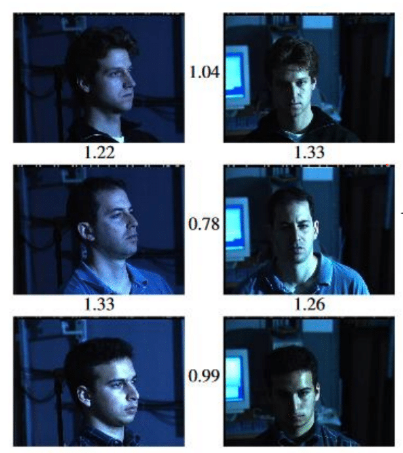

обучаются такие модели с помощью функции потерь под названием triplet loss. Это достаточно сложная кухня. Кому интересно прикладываю [статью](https://arxiv.org/abs/1503.03832) где это все подробно озвученно. 

Один из примеров использования embeddings - это сервис [Google Lens](https://lens.google.com/)

Вопрос, Можно ли используя подобные представления получить не используя метки, т.е. как-то обойтись без классического обучения с учителем?

## 2. Unsupervised Learning. Обучение без учителя

Т.е. в данной задаче у нас есть просто данные (без меток) и есть алгоритмы которые просто берут эти данные. И вместо того что бы что-то предсказывать на этих данных, они выявляют некоторую структуру в этих данных. Они дают некоторую информацию о том, что в этих данных происходит.
Например:

* Класстеризация, Clustering - группировка входных наших данных. 
* Выявление аномалий, Outlier detection - Например есть набор точек. И какие-то из них явно аномалии. И вот такие алгоритмы находят такие аномалии. 
* Learning Features - выучить какое-то представление всех данных, которые будут полезны в других задачах
* Generation - Создание новых вещей.

### 2.1 Autoencoder

Пример подобных задач является автоэнкодер. Представте что у нас есть только фотографии без меток и мы хотим получить какую-то нейросеть, которая преобразовывает картинку в некий вектор, который описывает то, что происходит в картинке на более высоком уровне. 
Допустим создадим нейросеть, которая на вход принимает картинку. И на выходе она тоже выдает картинку. И мы заставим  нейросеть получать ту же самую картинку.

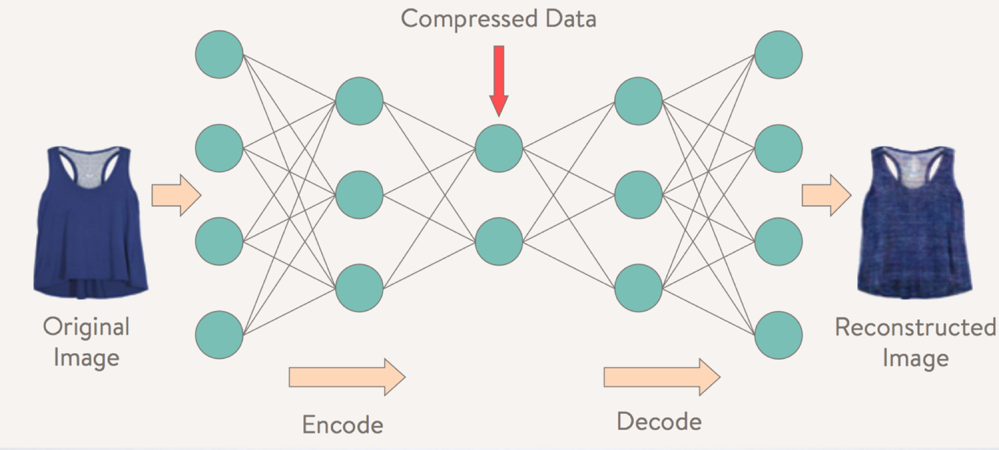

Функция потерь будет очень простой L2:

$$L = ||x_{out} - x_{in}||^2$$

И что бы это не выглядело, что мы просто учим нейросеть выдавать ту же самую картинку что и на выходе - мы акцентируем внимание на внутренем срединном слое (Compressed Data), который будет такого размера, что всю информацию о картинке туда не записать. И поэтому сети надо научиться как-то сжать эту информацию, так что бы она потом могла расжать ее наиболее эфективно. Для этого ей придется распознать на изображении определенные высокоуровневые фичи, что бы смочь потом реалистично их сгенерировать. Это внутренее представление картинки часто называют Latent Variable. Грубо говоря, некоторая латентная(внутреняя, скрытая) информация, которую сеть должна научиться извлекать из картинки и составить о ней представление. 

Зачем это может пригодиться?

Мы можем например взять получившийся энкодер и присобачить после слоя Compressed Data какой-нибудь слой классификации для обучения этого классификатора на задачу классификации. Т.е. используем это все как претрэйнинг. 

Допустим у нас куча неразмеченных данных. И немного размеченных. И мы сначала обучаем наш энкодер на неразмеченных. А потом уже добавив классификатор обучаем на маленьком размеченном датасете.

Но если честно в таком виде автоэнкодеры работают так себе. Они не дают такого богатово представления, какого от них ожидается. очень часто в таких моделях происходит overfitting. Получаемые энкодеры таким способом хорошо работают только для фиксированных точек в получающемся пространстве. Если мы хоть немного поменяем наш получившийся embedding, то наша модель выдаст ерунду.

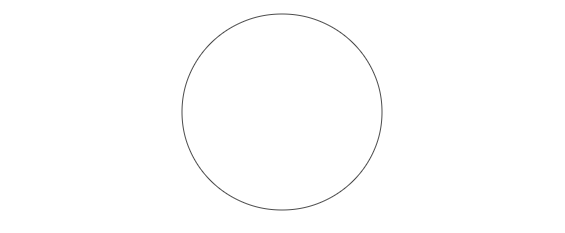

И люди работали над разными подходами для решения этой проблемы. И вот один из них:

### 2.2 Variational Autoencoder (VAE)

Идея его следующая: 

Вот у нас есть некоторое заданное пространство Z, в котором у нас есть наше latent-представление. И мы хотим что бы энкодер и декодер научились генерировать и распаковывать точки из него не из выколотых точек, а покрыть это пространство наиболее плотно. Как мы это будем делать?

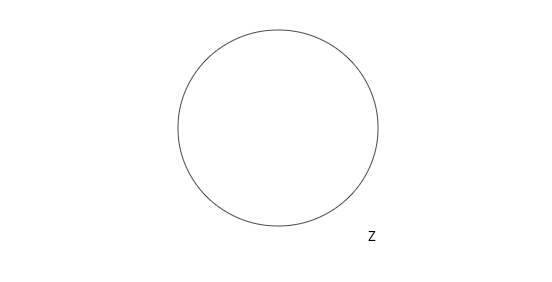

Наше внутренее представление мы разобъем на две части. Вместо того чтобы предсказывать один вектор или одну точку, мы будем предсказывать целый круг в этом пространстве (область пространства).

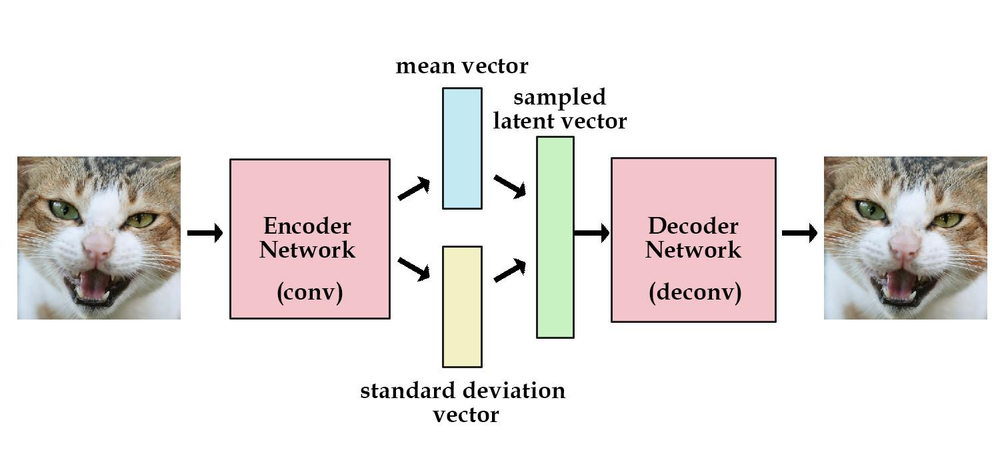

Для этого надо будет предсказать среднее и дисперсию: $$\mu,\sigma$$

Среднее будет соответсвовать центру круга, а дисперсия - радиусу. 

И затем на вход декодеру мы возьмем случайную точку в этом предсказанном кружке по формуле:

$$\mu + n\sigma\\n \equiv N(0,1)$$

И этот декодер должен будет по нему реконструировать туже картинку.

И наш лосс будет состоять из двух частей. Первый - это то что декодер может восстановить для этой случайной точки картинку:

$$L_r = ||x_{out} - x_{in}||^2$$

А второй лосс, будет стимулировать наш енкодер не делать слишком маленькие круги, а то мы вернемся к ситуации когда у нас точки, а не круги:
    
$$L_{KL} = D_{KL}(\mu, \sigma||N(0,1)) = 0.5\sum_{j=0}^{N}(1+log{\sigma_j}^2 - {\mu_j}^2 - {\sigma_j}^2)$$

Второй лосс говорит нам, что неплохо, что бы те сигма и мю что мы предсказываем были бы похожи на весь большой круг. И таким образом стимулируем чтобы эти круги были как можно больше. Эта метрика близости распределений. Т.е. она очень большая когда распределения далеко друг от друга и маленькая когда распределения одинаковы.

И в итоге мы эти два лосса складываем. 

Вот так примерно об вариационном автоэнкодере. У данного энкодера есть другая интерпретация на основе байесовских моделей. Он работает гораздо лучше. Но с этим предлагаю ознакомиться самим, если интересно:

[Оригинальная ссылка](https://arxiv.org/abs/1312.6114)  
[Ссылка которую следует читать вместо первой. Тут понятнее](https://arxiv.org/abs/1606.05908)  
[pytorch-статья](https://towardsdatascience.com/variational-autoencoder-demystified-with-pytorch-implementation-3a06bee395ed)

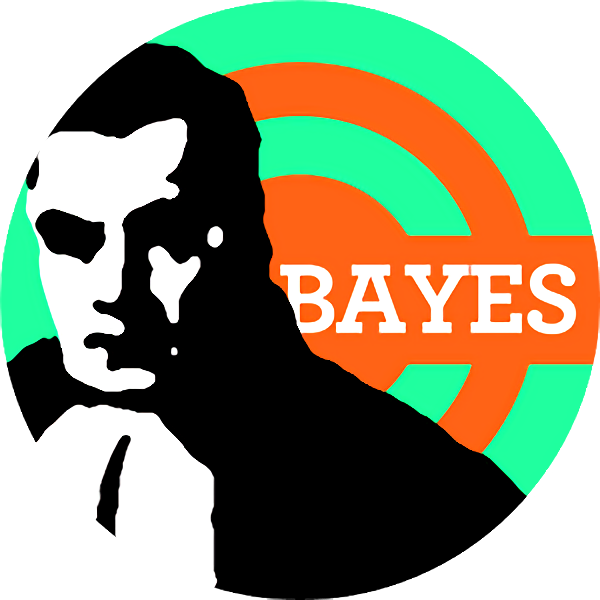

### 2.3 Интерполяции

Допустим у нас есть натренированный такой автоэнкодер. Что мы можем? Возьмем два лица. Представим их в latent-пространстве. Сравним их. И будем интерполирвать: построим прямую через точки их представляющие, насэмплим точек по этой прямой и дадим нашему декодеру их декомпозировать. Получим примерно следующее:

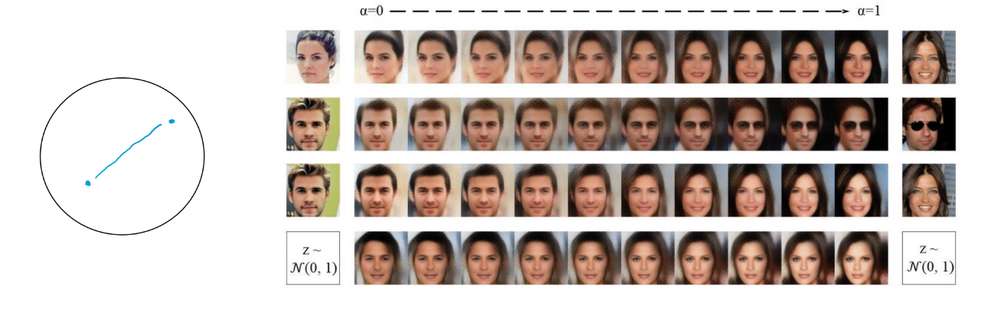

https://arxiv.org/abs/1610.00291

#### 2.3.1 Операции с latent space

Вот еще один способ как с этим можно играться: мы хотим найти в этом пространстве некое направление, которое соотвествует некоторому признаку. Например  мы хотим понять направление признака, что на лице есть улыбка.
Для этого мы возьмем например 50 лиц на которых есть улыбка и на которых нет. И посмотрим на наше пространство. Те лица на которых нет улыбки находятся в одной части пространства. Те где есть улыбка находятся в лругой части пространства. Мы можем усреднить эти лица(с улыбкой и без) и сможем подсчитать вектор в направлении между этими точками в нашем пространстве. И сможем увидить, что декодер начинает генерировать более улыбающиеся лица. 

Точно так же и сдругими признаками.

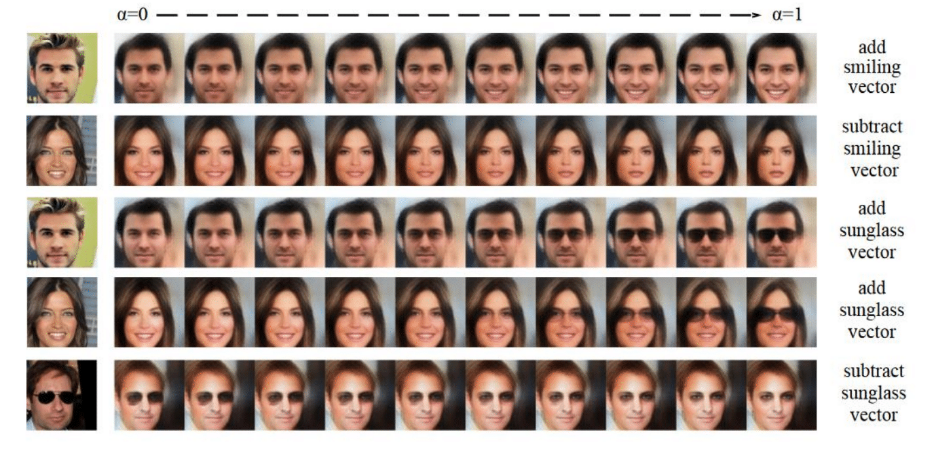

Все хорошо, но стоит отметить, что все эти картинки получаются довольно размытыми. Почему это происходит?

Проблема в том, что наша функция по реконструкции - это L2. Т.е. она минимизирует расстояния. И в случае когда мы не знаем что предсказывать или в случае когда много вариантов(бэкграунды везде разные) эффективнее всего предсказывать среднее. А среднее - это по определению размытие. И оказывается что очень многие функции потерь этому подвержены. 

## 3. Generative Advarials Networks (GANs)

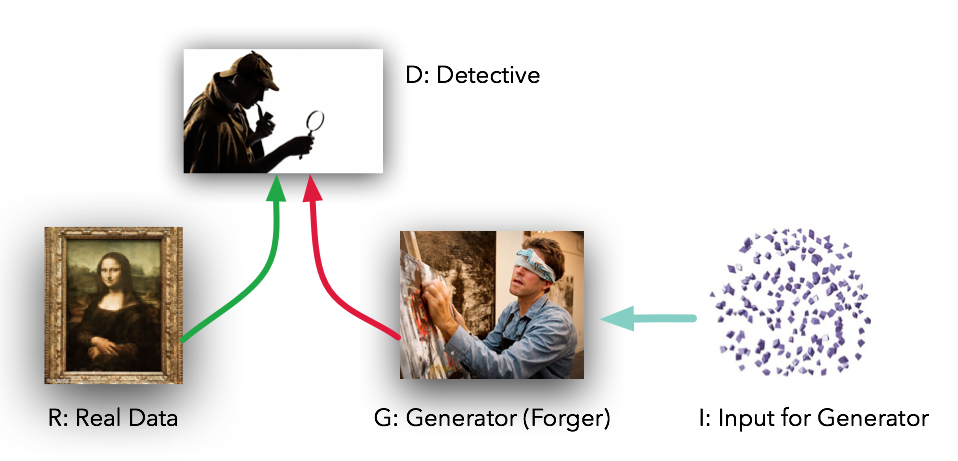

### 3.1Архитектура

Другой подход в решению той же задачи - generative advarials networks.


Они же:

* генеративные соревновательные сети
* порождающие соперничающие сети
* порождающие соревнующиеся сети

Идея этих сетей состоит в том, что бы стравить между собой две нейросети, которые в процессе состязания учатся генерировать реалистичные картинки.

### Дискриминатор ($D$)

Модель дискриминатора берет входные данные (реальные или сгенерированный) и предсказывает к какому из этих двух классов принадлежат эти данные.

После процесса обучения модель дискриминатора отбрасывается, поскольку нас уже интересует только генерация данных.

### Генератор ($G$)

Задача генератора - создавать «поддельные» изображения, похожие на те, что в обучающей выборке. 
Во время обучения генератор постоянно пытается обыграть дискриминатор, улучшая качество подделок.


### Подход

У нас есть две сети. Первая называется Generator. Она на вход будет получать некоторый вектор шума z, который соотвествует нашему latent-пространству. И теперь  генератор должен из этого шума преобразовать картинку.   
И у нас будет другая сеть Descriminator, которой на вход подается картинка. Она прогоняет ее через сверточную сеть и на выход дает только одно число. Такой бинароный классификатор. таким образом эта нейросеть должна отличить реальную картинку от фальшивой. Т.е. Дискриминатору на вход будут приходить и фальшивые картинки от генератора и реальные картинки из датасета. и наш процесс обучения будет проходить так, что дискриминатор пытается разобраться реальная картинка или нет. А генератор будет учиться обманывать дискриминатор. И постепенно генератор будет генерировать все более реалистичные картинки. Дискриминатор будет все лучше и лучше отличать фальшивые от реальных. И в конце концов мы натренируем генератор до такого состояния, что дискриминатор больше не сможет распознать реальное или фальшивое изображение пришло на вход. В этом и состоит цель такого обучения.

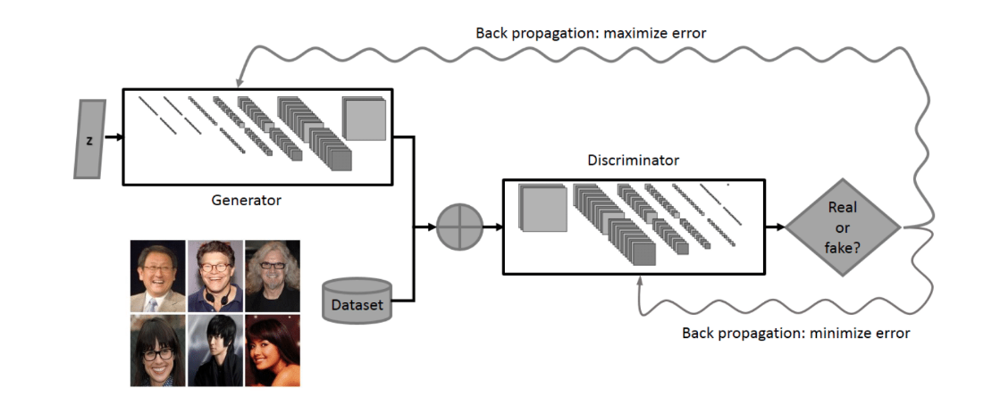

### 3.2 Процесс обучения

1. Возьмем наш батч из случайного шума. Т.е. сгенерируем m примеров векторов шума:

$$\left\{ z_1, ..., z_m\right\}$$

2. Сгенерируем m примеров из датасета, т.е. реальных картинок:

$$\left\{ x_1, ..., x_m\right\}$$

3. Прогоним эти m примеров шума через генератор и получим m сгенерированных картинок. 

4. И прогоним два батча через дискриминатор. При этом у сгенерированных картинок будет отрицательный лэйбл. А у реальных - положительный лэйбл.

5. Мы проведем k шагов обучения дискриминатора, в которых он отличит реальные данные от нереальных. В начале обучения генератор генерирует по сути шум размера картинки. Поэтому дискриминатор очень быстрои удаччно научается различать реальные картинки от нереальных. 
Здесь мы обновляем веса Дискриминатора.

$$\nabla_{\Theta_d} \frac{1}{m} \sum_{i=1}^{m} (logD(x_i) + log(1- D(G(z_i))))$$

6. Обучаем Генератор. Мы опять генерируем m-батч случайных примеров z. Из них генерируем  батч картинок. Прогоняем их через Дискриминатор. Предположим что Дискриминатор все их классифицирует как неправильные. А потом делаем шаг оптимизации Генератора, т.е. двигаемся в обратном направлении с замороженными весами Дискриминатора.

$$\nabla_{\Theta_g} \frac{1}{m} \sum_{i=1}^{m} log(1- D(G(z_i)))$$

7. Затем мы возвращаемся в пункт 1. где снова обучаем Дискриминатор. Здесь Генератор уже чему-то обучился и Дискриминатору приходятся прдумывать как все-таки отличать лучше. И мы так прогоняем много и много раз. Наши Дискриминатор и Генератор таким образом сражаются кто лучше. 

В итоге мы надеемся, что в конце получим Генератор, который получив на вход случайный шум сможет генерировать правдоподобные картинки.

### Если совсем коротко, то:

Д и Г играют в игру с двумя играками в minmax игру. Т.е. мы ищем такие веса Г, коорые минимизируют функцию v(G,D), которая максимизируется с весами Д. Т.е. мы хотим найти такие веса Г, что как бы веса Д не пытались максимизировать функцию ошибки V - у них бы ничего не вышло. 

Т.е. мы хотим создать такой Г, что он настолько хорошо генерирует картинки, что не существует Д, который бы мог их отличить.

$$\min _{G} \max _{D} V(D, G)=\mathbb{E}_{\boldsymbol{x} \sim p_{\text {data }}(\boldsymbol{x})}[\log D(\boldsymbol{x})]+\mathbb{E}_{\boldsymbol{z} \sim p_{\boldsymbol{z}}(\boldsymbol{z})}[\log (1-D(G(\boldsymbol{z})))]$$

Где: 
* $x$ - реальные данные из обучающй выборки
* $D(x)$ - результат работы дискриминатора, т.е. вероятность того, что перед нами несгенерированные данные
* $z$ - случайный вектор фиксированной длины, выбранный из нормального распределения
* $G(z)$ - сгенерированные из $z$ данные

Задача для $G$ - генерировать данные $p_g$ с таким же распределением как и у реальных данных  $p_{data}$ .
Цель $D$ же - отличать сгенерированные данные от оригиналов. 
Тогда $D(G(z))$ - вероятность того, что данные из генератора являются реальными. Идеальный результат обучения GAN - $p_{data} = p_g$

### Пример про фальшивомонетчика и полицейского:

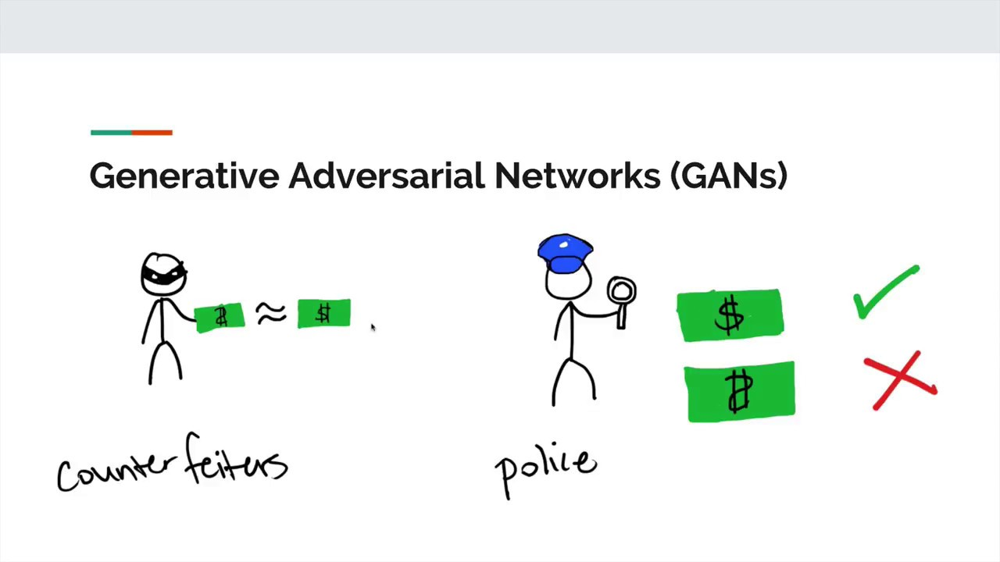

### Vanilla GAN

Рассмотрим реализацю самой первой статьи по GAN'ам на классическом датасете MNIST 

Generative Adversarial Nets [Ian J. Goodfellow](https://www.youtube.com/watch?v=Z6rxFNMGdn0) (2014) https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf  

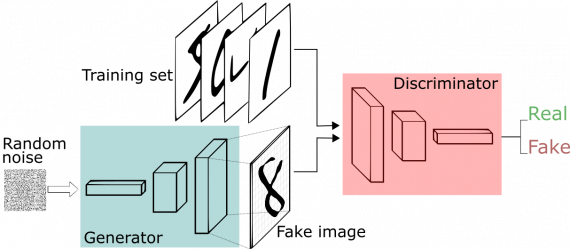

<h1><center>Часть 2. Практика</center></h1>

## 0. Подготовка
Подключаем нужные модули и библиотеки

In [1]:
import os
import numpy as np
import math

from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch

########### Вывод изображений и их сохранение
import matplotlib.pyplot as plt
from IPython import display
from torchvision.utils import save_image, make_grid

In [2]:
%%time

UsageError: %%time is a cell magic, but the cell body is empty. Did you mean the line magic %time (single %)?


Определим нужное нам устройство:

In [2]:
use_cuda = torch.cuda.is_available()
# device = torch.device("cpu")
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)

cpu


### 1. Загрузка датасета

Встроенными возможностями загружаем датасет [MNIST](http://yann.lecun.com/exdb/mnist/):

In [3]:
img_size = 28 # размер картинки которую мы будет подавать в нейронные сети
channels = 1 # количество каналов в нашей картинке
batch_size = 16 # размер батча
img_shape = (channels, img_size, img_size) # полный шейп нашей картинки

real_data = torch.utils.data.DataLoader(
    datasets.MNIST(
        "./data/mnist",
        train=True,
        download=True,
        transform=transforms.Compose(
            [transforms.Resize(img_size), transforms.ToTensor(), transforms.Normalize([0.5], [0.5])]
        ),
    ),
    batch_size=batch_size,
    shuffle=True,
)

Вытащим часть сэмпла и посмотри что внутри:

img_shape = (1, 28, 28)
lable_shape = torch.Size([])
img_shape after squeeze = (28, 28)


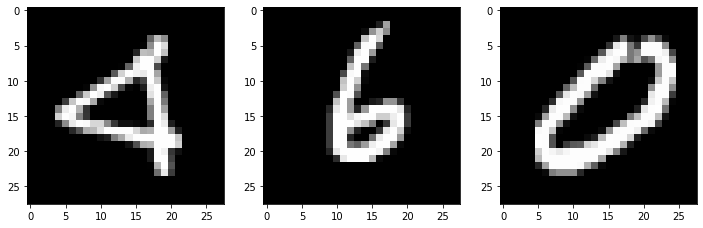

In [4]:
dataiter = iter(real_data)
images, labels = dataiter.next()
images = images.numpy()

print(f'img_shape = {images[0].shape}')
print(f'lable_shape = {labels[0].size()}')

# np.squeeze - позволяет избавиться от размерности где равно 1 в тензоре
img = np.squeeze(images[0])
print(f'img_shape after squeeze = {img.shape}')

img1 = np.squeeze(images[1])
img2 = np.squeeze(images[2])

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (12,4))
ax1.imshow(img, cmap='gray')
ax2.imshow(img1, cmap='gray')
ax3.imshow(img2, cmap='gray')

In [5]:
# Функция для вывода и сохранения изображения
def sample_image(static_sample, save_img = False):
    npimg = make_grid(static_sample.data[:25]).cpu().numpy()
    fig, ax = plt.subplots(figsize=(7, 7))
    ax.imshow(np.transpose(npimg, (1,2,0)), interpolation="nearest")
    if save_img:
        save_image(gen_imgs.data[:25], "images/%d.png" % batches_done, nrow=5, normalize=True)

### 2. Создание модели

#### 2.1 Генератор:

Генератор G предназначен для отображения вектора скрытого пространства (z) в пространство данных. Поскольку наши данные являются изображениями, преобразование z в пространство данных в конечном итоге означает создание изображения того же размера, что и обучающие изображения (то есть 1x28x28).

In [10]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        
        # Использование таких словарей позволяет нам варьировать параметры нашей сети в процессе использования
        self.activations = nn.ModuleDict([
                ['lrelu', nn.LeakyReLU(0.2, inplace=True)],
                ['relu', nn.ReLU(0.2)]])
        
        def block(in_feat, out_feat, normalize=True, activation='relu'): #activation='relu
            layers = [nn.Linear(in_feat, out_feat)] # Если мы создаем последовательность слоев - то мы задаем их
                                                    # с помощью списка.
            if normalize:
                layers.append(nn.BatchNorm1d(out_feat, 0.8))
            layers.append(self.activations[activation]) # Эта сторчка означает тоже самое что и
                                                       # layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *block(latent_dim, 128, normalize=False), # Звездочка означает unpacking списка
            *block(128, 256, activation='lrelu'),
            *block(256, 512),
            *block(512, 1024),
            nn.Linear(1024, int(np.prod(img_shape))),
            nn.Tanh()
        )
        # 2

    def forward(self, z):
        img = self.model(z)
        img = img.view(img.size(0), *img_shape)
        return img


#### ... Небольшое отступление 
Создание своих слоев. Если все правильно оформить, то созданный кастомный слой можно будет использовать внутри pytorch как обычный слой.

In [8]:
class CustomLinearLayer(nn.Module):
    def __init__(self, size_in, size_out):
        super().__init__()
        self.size_in, self.size_out = size_in, size_out
        
        weights = torch.Tensor(size_out, size_in)
        self.weights = nn.Parameter(weights) # Обьявляем веса кка параметры слоя

        bias = torch.Tensor(size_out)
        self.bias = nn.Parameter(bias)

        nn.init.uniform_(self.weights, -0.005, 0.005) 
        nn.init.uniform_(self.bias, -0.005, 0.005)  

    def forward(self, x):
        # По формуле линейного слоя, нам нужно умножить наши данные на трнспонированные веса и добавить смещение
        w_times_x = torch.mm(x, self.weights.t())
        return torch.add(w_times_x, self.bias)  

nn.init.uniform_ Позволяет нам задать значения с помощью нормального распределения

#### nn.init
https://pytorch.org/docs/stable/nn.init.html

#### 2.2 Дискриминатор:

Как уже упоминалось, дискриминатор D представляет собой сеть двоичной классификации, который принимает изображение в качестве входных данных и выводит скалярную вероятность того, что входное изображение является реальным (в отличие от фальшивого). Здесь D принимает входное изображение размером 1x28x28

In [7]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()

        self.model = nn.Sequential(
            nn.Linear(int(np.prod(img_shape)), 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
            nn.Sigmoid(),
        )
  

    def forward(self, img):
        img_flat = img.view(img.size(0), -1)
        validity = self.model(img_flat)

        return validity

# 3. Обучение

Инициализация:

In [8]:
n_epochs = 200 # количество эпох
lr = 0.0002 # шаг обучения

b1 = 0.5 # гиперпараметр для оптимайзера Adam
b2 = 0.999 # гиперпараметр для оптимайзера Adam

latent_dim = 100 # Размерность случайного вектора, который подается на вход генератору


sample_interval = 25 # количество картинок для отображения процесса обучения

In [11]:
generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Для каждой нейронки свой опитимизатор
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1, b2))

# Но вот функция ошибки у нас будет одна общая
adversarial_loss = torch.nn.BCELoss()

In [12]:
d_loss_history = []
g_loss_history = []

Процесс обучения:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 0/200] [Batch 3200/3750] [D loss: 0.211814] [G loss: 2.186900]


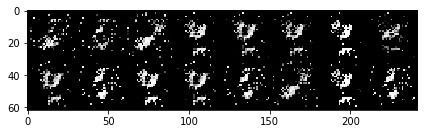

<Figure size 432x288 with 0 Axes>

KeyboardInterrupt: 

In [13]:
import matplotlib.patches as mpatches

red_patch = mpatches.Patch(color='red', label='D loss')
green_patch = mpatches.Patch(color='green', label='G loss')



for epoch in range(n_epochs):
    for i, (imgs, labels) in enumerate(real_data):
        
##################### Лnnейблы для данных: 1 - настоящие, 0 - сгенерированные ########
        valid = torch.FloatTensor(batch_size, 1).fill_(1.0).to(device)
        fake = torch.FloatTensor(batch_size, 1).fill_(0.0).to(device)

        real_imgs = imgs.type(torch.FloatTensor).to(device)


######################  Тренировка генератора    ##########################

        optimizer_G.zero_grad()
    
        #генерация шума
        z = torch.FloatTensor(np.random.normal(0, 1, (batch_size, latent_dim))).to(device)
        
        # Генерируем даные Генератором на основе шума
        gen_imgs = generator(z)
        
        # Подаем сгенерированые данные на Дискриминатор 
        validity = discriminator(gen_imgs)
        
        # Тут сравниваем предсказанные значения Дискриминатора(на основе сгенерировнных данных) с настоящими
        g_loss = adversarial_loss(validity, valid)
        
        # Делаем шаг обучения нашего Генератора
        g_loss.backward()
        optimizer_G.step()

######################  Тренировка дискриминатора    ##########################

        optimizer_D.zero_grad()
        
        # Получаем предсказания дискриминатора на основе реальных данных
        real_pred = discriminator(real_imgs)
        
        # Тут сравниваем предсказанные значения Дискриминатора(на основе настоящих данных) с настоящими
        d_real_loss = adversarial_loss(real_pred, valid)
        
        # Опять делаем предсказание на Дискриминаторе с помощью сгенерированных данных
        fake_pred = discriminator(gen_imgs.detach())
        
        # расчитываем ошибку предсказанного с фейковыми лейблами
        d_fake_loss = adversarial_loss(fake_pred, fake)
        
        # И усредняем два лосса в один
        d_loss = (d_real_loss + d_fake_loss) / 2

        d_loss.backward()
        optimizer_D.step()
        
######## Отображение процесса обучения и вывод функций потерь ############
        batches_done = epoch * len(real_data) + i
    
        if batches_done % sample_interval == 0:
            with torch.no_grad():
                plt.clf()

                display.clear_output(wait=False)
                sample_image(gen_imgs)
                print("[Epoch %d/%d] [Batch %d/%d] [D loss: %f] [G loss: %f]"% (epoch, n_epochs, i, len(real_data), d_loss.item(), g_loss.item()) ) 


                display.display(plt.gcf())

                d_loss = d_loss.cpu().detach()
                g_loss = g_loss.cpu().detach()


                d_loss_history.append(d_loss)
                g_loss_history.append(g_loss)

                plt.plot(np.log(np.array(d_loss_history)), label='D loss', color = 'red')
                plt.plot(np.log(np.array(g_loss_history)), label='G loss', color = 'green')
                plt.legend(handles=[red_patch, green_patch])
                plt.show()

            

In [14]:
class Autoencoder(nn.Module):
    
    def __init__(self, input_dim, hidden):
        super().__init__()
        
        self.hidden_1 = nn.Linear(input_dim, hidden*2)
        self.hidden_2 = nn.Linear(hidden*2, hidden)
        self.hidden_3 = nn.Linear(hidden, hidden*2)
        self.hidden_4 = nn.Linear(hidden*2, input_dim)
        
    def generate_vector(self, x):
        x = x.view(x.size(0), -1)
        x = self.hidden_1(x)
        return self.hidden_2(x)
        
    def forward(self, x):
        saved_shape = x.size()
        x = self.generate_vector(x)
        x = self.hidden_3(x)
        x = self.hidden_4(x)
        return x.view(saved_shape)
        

In [16]:
autoencoder = Autoencoder(28*28, 16)
optimizer_ae = torch.optim.Adam(autoencoder.parameters())

loss = torch.nn.MSELoss()
def custom_MSE(x, target):
    return loss(x.view(x.size(0), -1), target=target.view(target.size(0), -1))

In [17]:
from tqdm import tqdm, tqdm_notebook

In [18]:
for epoch in tqdm_notebook(range(n_epochs)):
    for i, (imgs, labels) in tqdm(enumerate(real_data)):
        optimizer_ae.zero_grad()
        outputs = autoencoder(imgs)
        
        loss_val = custom_MSE(outputs, imgs)
        loss_val.backward()
        optimizer_ae.step()

/home/kinetik/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """Entry point for launching an IPython kernel.


3750it [00:21, 171.90it/s]
1066it [00:06, 170.48it/s]

KeyboardInterrupt: 

In [19]:
ds = datasets.MNIST(
        "./data/mnist",
        train=True,
        download=False,
        transform=transforms.Compose(
            [transforms.Resize(img_size), transforms.ToTensor(), transforms.Normalize([0.5], [0.5])]
        ),
    )

img_shape = (1, 28, 28)
lable_shape = torch.Size([])
img_shape after squeeze = (28, 28)


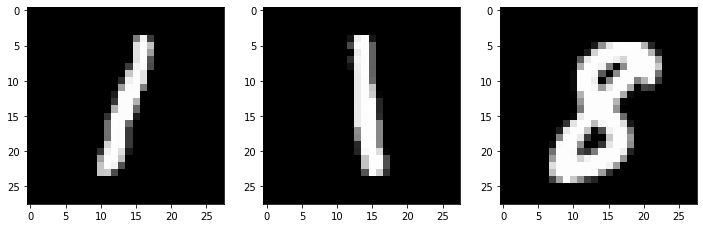

In [29]:
dataiter = iter(real_data)
images, labels = dataiter.next()
images = images.numpy()

print(f'img_shape = {images[0].shape}')
print(f'lable_shape = {labels[0].size()}')

# np.squeeze - позволяет избавиться от размерности где равно 1 в тензоре
img = np.squeeze(images[0])
print(f'img_shape after squeeze = {img.shape}')

img1 = np.squeeze(images[1])
img2 = np.squeeze(images[2])

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (12,4))
ax1.imshow(img, cmap='gray')
ax2.imshow(img1, cmap='gray')
ax3.imshow(img2, cmap='gray')

In [30]:
pred = autoencoder.generate_vector(torch.FloatTensor(np.concatenate([img.reshape(1, 28, 28), img1.reshape(1, 28, 28), img2.reshape(1, 28, 28)])))

In [31]:
pred

tensor([[-0.6797,  0.2951, -0.4118, -0.8730, -0.4180, -0.5736,  0.0968, -2.7339,
          0.7494,  1.8824,  2.3691, -1.7724, -1.5658, -1.1538,  3.0414,  1.7814],
        [-2.6872,  2.0732, -1.4893,  0.0707, -2.8168,  0.2742, -0.9089, -0.7881,
         -1.1456,  0.0557,  0.2730, -2.3730, -1.1127, -1.8829,  1.9193,  0.9675],
        [-2.3655, -0.3297, -2.4460,  0.9209,  0.5591,  3.5480, -2.7424, -0.8179,
          1.4906, -0.7023, -1.0843,  0.3122, -0.9837,  0.9127,  1.6988,  2.9666]],
       grad_fn=<AddmmBackward0>)

In [32]:
loss(pred[0], pred[1]), loss(pred[2], pred[1]), loss(pred[0], pred[2])

(tensor(2.1784, grad_fn=<MseLossBackward0>),
 tensor(3.8405, grad_fn=<MseLossBackward0>),
 tensor(4.4738, grad_fn=<MseLossBackward0>))

Анимация первых 88 эпох обучения

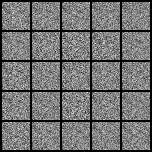

In [76]:
torch.save(generator.state_dict(), "vanilla_gan.pth")

### Примеры работы GAN:¶
https://www.thispersondoesnotexist.com/ - генерация несуществующих лиц   
https://thiscatdoesnotexist.com/ - генерация несуществующих котов  
https://aiweirdness.com/post/182633984547/gancats) - ошибки в генерации котов  
https://www.youtube.com/watch?v=PCBTZh41Ris - генерация танцевальных движений  

[Зоопарк GAN'ов](https://github.com/hindupuravinash/the-gan-zoo)

# Бонус: немного квантов

У пайторча так же есть направление разработок связанных с [квантовым машинным обучением](https://medium.com/xanaduai/training-quantum-neural-networks-with-pennylane-pytorch-and-tensorflow-c669108118cc)  
[pypi-библиотека](https://pypi.org/project/pytorch-quantum/)  
[Пример написания классификатора](https://qiskit.org/textbook/ch-machine-learning/machine-learning-qiskit-pytorch.html)  

[tensorflow-quantum](https://www.tensorflow.org/quantum)  
[pypi-библиотека](https://pypi.org/project/tensorflow-quantum/)  
[Статья как пользоваться](https://habr.com/ru/company/raiffeisenbank/blog/523932/)

[Основы квантовых вычислений](https://www.coursera.org/learn/kvantovyye-vychisleniya/home/welcome)  